#### The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.


# Load libraries

In [1]:
import cv2
import glob
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

import os
os.chdir('D:/Advanced-Lane-Finding-Project')


# Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.

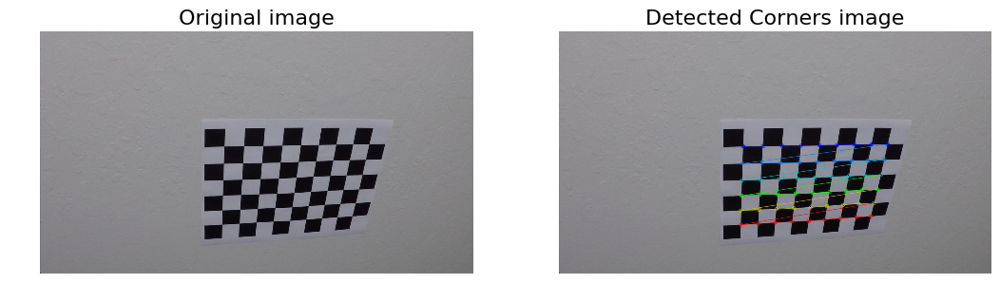

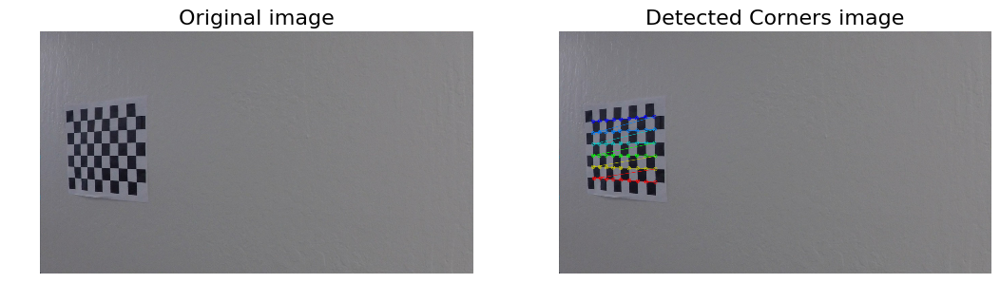

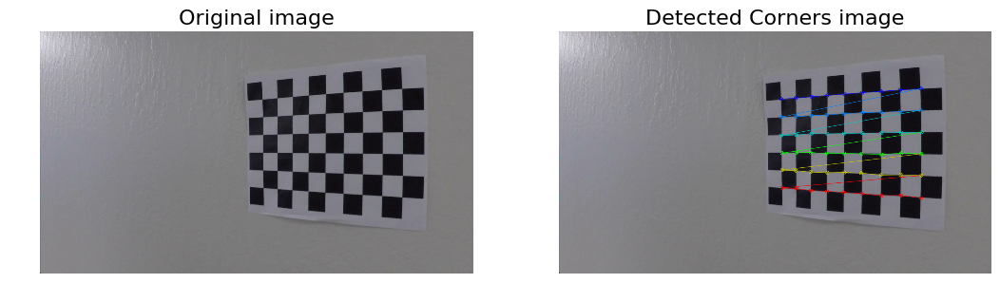

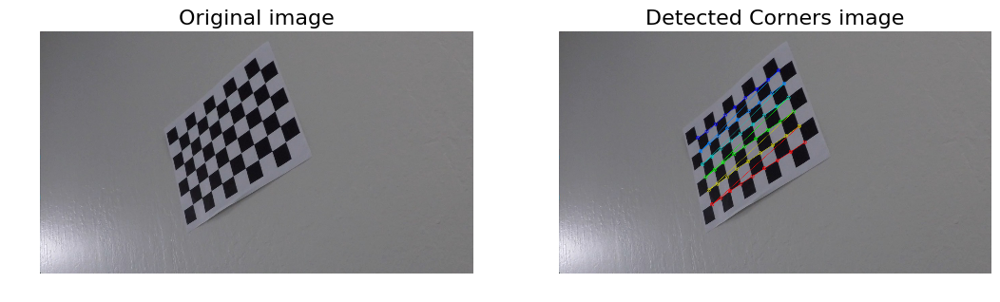

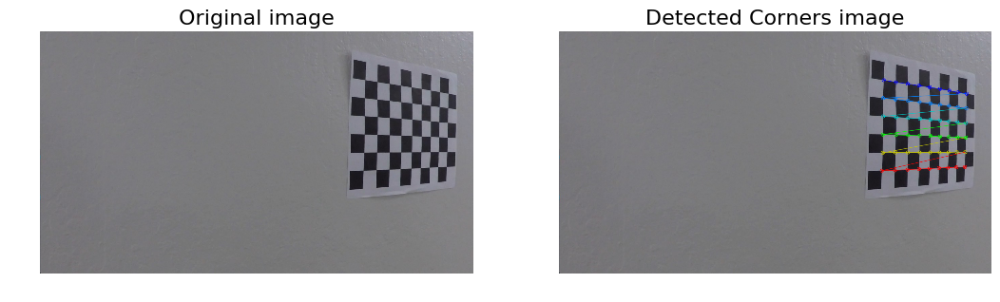

...

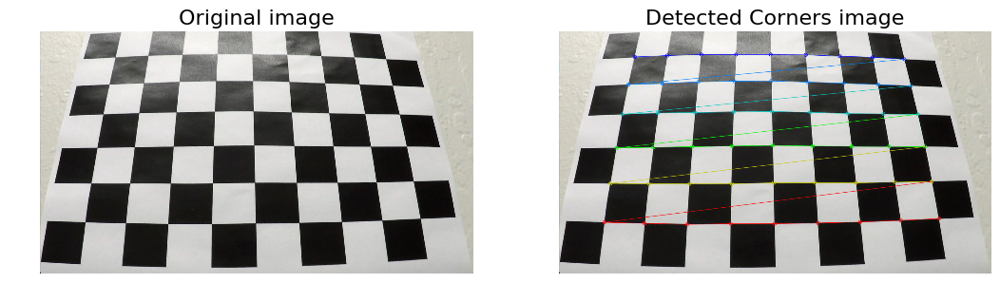

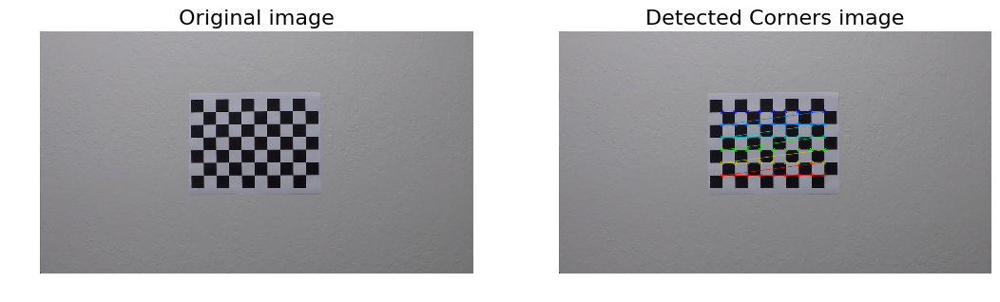

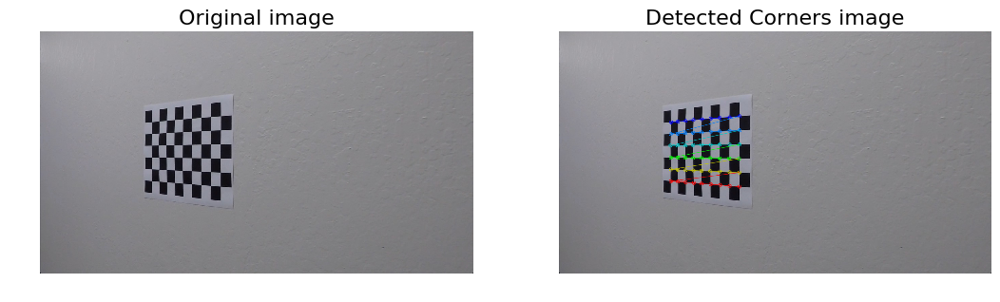

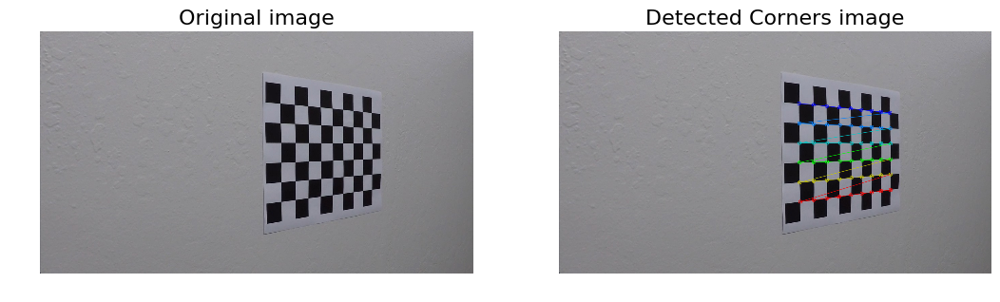

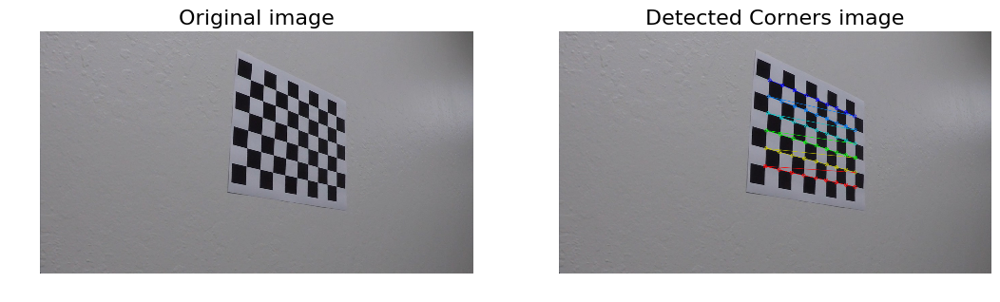

In [2]:
nx = 9   # (Number of corners in the x-direction (columns))
ny = 6   # Number of corners in the y-direction (row)

# Prepare object/image points storages
objpoints = [] # 3D points
imgpoints = [] # 2D points

# Prepare object points values
objp = np.zeros((nx*ny,3),np.float32)
objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1,2) 


# find chessboard corners and draw them
for im in glob.glob('camera_cal/calibration*.jpg'):
    image = mpimg.imread(im)
    draw_copy = np.copy(image)
    gray = cv2.cvtColor(draw_copy,cv2.COLOR_RGB2GRAY)
    ret,corners = cv2.findChessboardCorners(draw_copy,(nx,ny))
    
    # store points if corners are found
    # Draw detected corners on 
    
    if ret == True:
        imgpoints.append(corners)
        objpoints.append(objp)
        cv2.drawChessboardCorners(draw_copy,(nx,ny),corners,ret)
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,6))
        ax1.imshow(image)
        ax1.set_title('Original image', fontsize=16)
        ax2.imshow(draw_copy)
        ax2.set_title('Detected Corners image', fontsize=16)
        ax1.axis('off')
        ax2.axis('off')
        plt.subplots_adjust(left=0., right=1, top=0.7, bottom=0.)
    

# Apply a distortion correction to raw images

(-0.5, 1279.5, 719.5, -0.5)

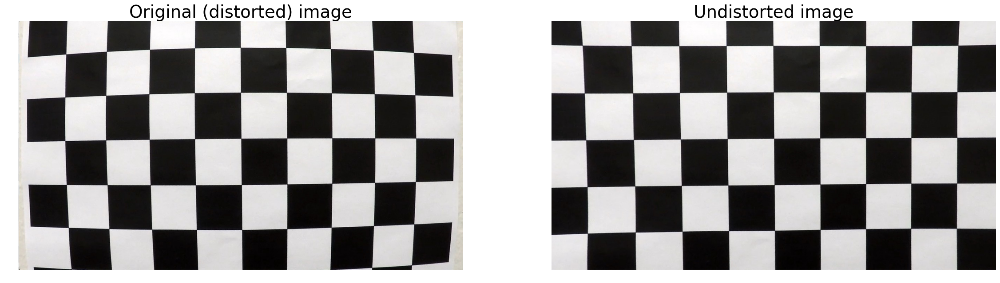

In [3]:
# Camera calibration
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints,(image.shape[:2]), None, None)

def undistort_image(image):
    return cv2.undistort(image,mtx,dist,None,mtx)

image = mpimg.imread('camera_cal/calibration1.jpg')
undistort = undistort_image(np.copy(image))
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(22,12))
ax1.imshow(image)
ax1.set_title('Original (distorted) image', fontsize=28)
ax2.imshow(undistort)
ax2.set_title('Undistorted image', fontsize=28)
plt.subplots_adjust(left=0., right=1, top=0.7, bottom=0.)
ax1.axis('off')
ax2.axis('off')
# plt.savefig('./output_images/undistort_output.png')

    

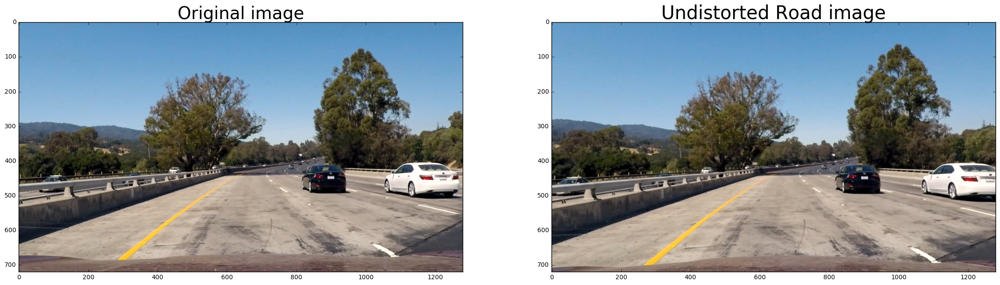

In [4]:
# Distortion correction test on a raw road image
test_img = mpimg.imread('test_images/test1.jpg')
undist_test = cv2.undistort(test_img, mtx, dist, None, mtx)

f, (ax1, ax2)  = plt.subplots(1, 2, figsize=(22,12))
ax1.imshow(test_img)
ax1.set_title('Original image', fontsize=28)
ax2.imshow(undist_test)
ax2.set_title('Undistorted Road image', fontsize=30)
plt.subplots_adjust(left=0., right=1, top=0.7, bottom=0.)
# plt.savefig('./output_images/undistort_road_image.png')

# Use color transforms, gradients,ROI to create a thresholded binary image.

(-0.5, 1279.5, 719.5, -0.5)

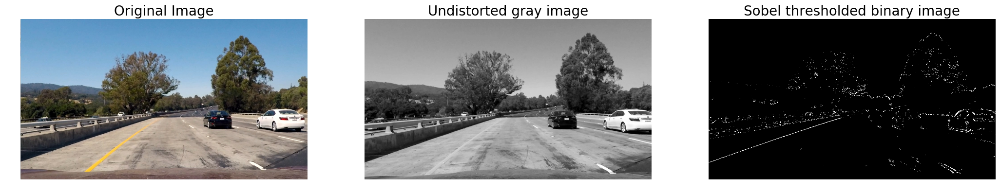

In [5]:
# Creat functions for edge detection

# Calculate directional gradient

def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
    # Apply x or y gradient and and make absolute values
    # take an absolute Sobel in the x or y direction
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(img, cv2.CV_64F, 1, 0))  #  Take the derivative in x
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(img, cv2.CV_64F, 0, 1))  #  Take the derivative in y
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    return binary_output


# Calculate gradient magnitude
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1
    return binary_output

# Calculate gradient direction
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1
    return binary_output

    
    
# Plot Original,Undistort and thresholded image

f, (ax1, ax2,ax3) = plt.subplots(1, 3, figsize=(20,10))
ax1.set_title('Original Image',fontsize=20)
ax1.imshow(test_img)

test_img = cv2.undistort(test_img,mtx,dist,None,mtx)
undistort_gray = cv2.cvtColor(np.copy(test_img), cv2.COLOR_RGB2GRAY)

# Define sobel kernel size
ksize = 7

# Apply each of the thresholding functions
gradx = abs_sobel_thresh(undistort_gray, orient='x', sobel_kernel=ksize,  thresh=(20, 255))  # changed from (20, 255)
grady = abs_sobel_thresh(undistort_gray, orient='y', sobel_kernel=ksize,  thresh=(80, 255))  # changed from (80, 255)
mag_binary = mag_thresh(undistort_gray, sobel_kernel=ksize, mag_thresh=(50, 255))
dir_binary = dir_threshold(undistort_gray, sobel_kernel=ksize, thresh=(.65, 1.05))

# Combine all the thresholding information
combined = np.zeros_like(dir_binary)
combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1

ax2.set_title('Undistorted gray image',fontsize=20)
ax2.imshow(undistort_gray, cmap='gray')

ax3.set_title('Sobel thresholded binary image',fontsize=20)
ax3.imshow(combined, cmap='gray')
plt.subplots_adjust(left=0., right=1, top=0.7, bottom=0.)
ax1.axis('off')
ax2.axis('off')
ax3.axis('off')

# plt.savefig('./output_images/binary_combo_image.png')    
        

# Color thresholded binary image function

In [6]:
def color_threshold(image,stresh=(0,255),vthresh=(0,255)):
    hls = cv2.cvtColor(image,cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    s_binary= np.zeros_like(s_channel)
    s_binary[(s_channel >= stresh[0]) &(s_channel <=stresh[1])]=1
    
    hsv = cv2.cvtColor(image,cv2.COLOR_RGB2HSV)
    v_channel = hsv[:,:,2]
    v_bianry = np.zeros_like(v_channel)
    v_bianry[(v_channel >= vthresh[0])&(v_channel <= vthresh[1])] =1
    
    output= np.zeros_like(s_channel)
    output[(s_binary==1)&(v_bianry==1)]=1
    return output


# Define Region of Interest (ROI)

In [7]:
def region_of_interest(img,vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image

# Extracted from Lane finding P1 file

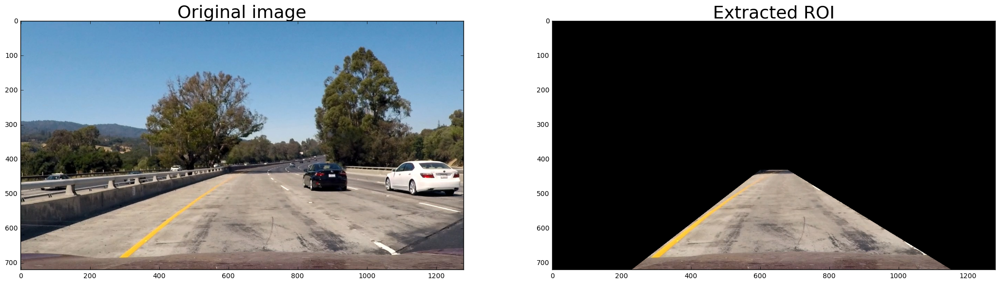

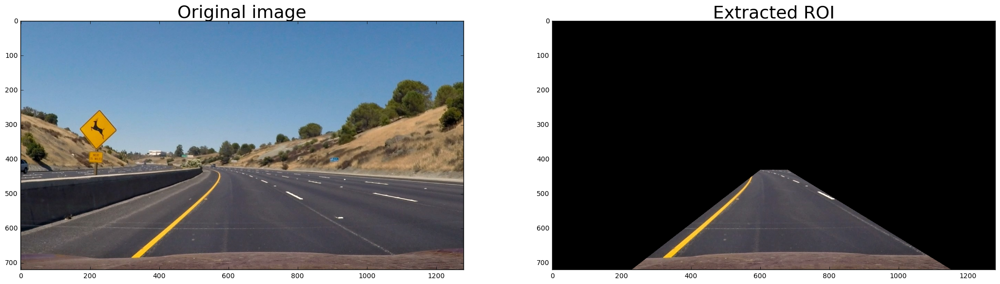

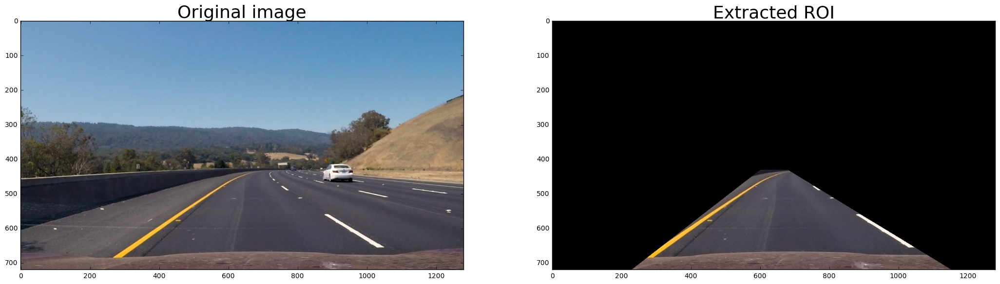

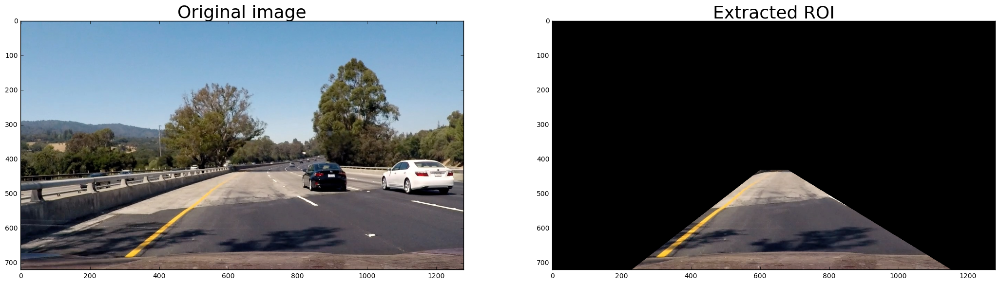

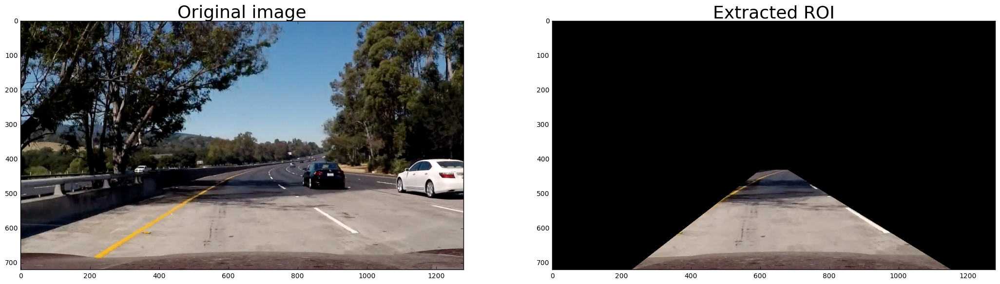

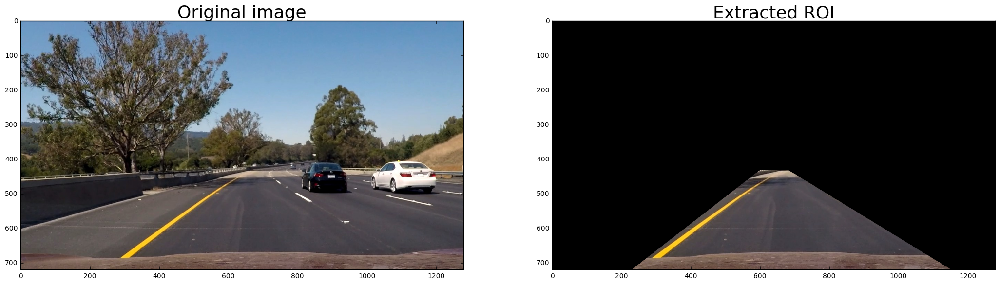

In [8]:
# Draw ROI on original images

# After experimenting different values, below values are chosen for ROI 
roi_vertices = np.array([[230,720],[600,432],[680,432], [1150,720]]) 

for img in glob.glob('test_images/test*.jpg'):
    img = mpimg.imread(img)
    f, (ax1,ax2) = plt.subplots(1,2, figsize=(20,10))
#     cv2.polylines(np.copy(img),[roi_vertices],True,(0,255,255))  
    ax1.imshow(img)
    ax1.set_title('Original image',fontsize=26)
    ax2.imshow(region_of_interest(np.copy(img), [roi_vertices]), cmap='gray')
    ax2.set_title('Extracted ROI',fontsize=26)
    plt.subplots_adjust(left=0., right=1, top=0.7, bottom=0.)
    plt.show()
#     plt.savefig('./output_images/extracted_ROI')   

# Apply a perspective transform to rectify binary image ("birds-eye view").

In [9]:
# src and dst require to calculate persective trainsform
# values are chosen after trial and error expermantation

src = np.array([(585, 460), (203, 720), (1127,720), (695,460)])
dst = np.array([(320,0), (320,720), (960,720), (960,0)])

In [10]:
# Given src and dst points, calculate the perspective transform matrix
PerspectiveXform = cv2.getPerspectiveTransform(src.astype(np.float32), dst.astype(np.float32))
PerspectiveInv = cv2.getPerspectiveTransform(dst.astype(np.float32), src.astype(np.float32))  

#  Warp the image using OpenCV warpPerspective()
def warpperspective (img):
    return cv2.warpPerspective(img,PerspectiveXform,(img.shape[1],img.shape[0]), flags=cv2.INTER_LINEAR)

# Images with Src and Dst points visualisation

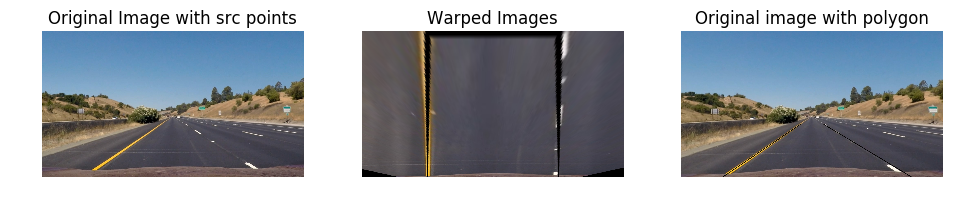

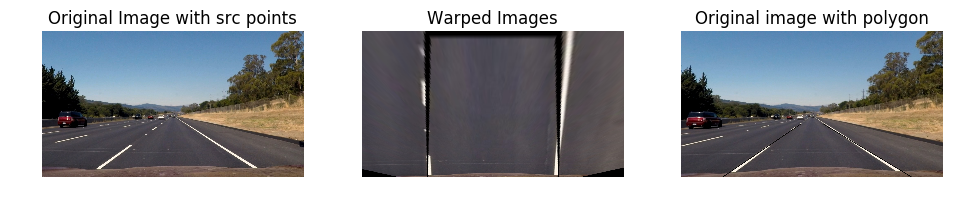

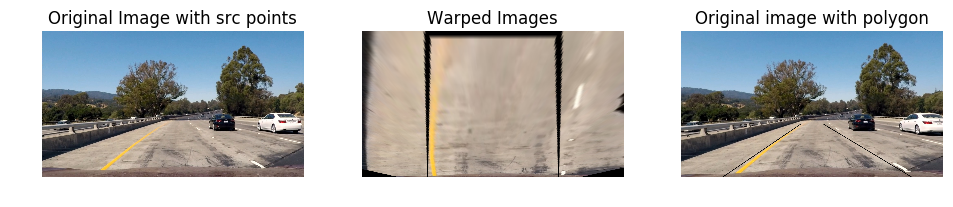

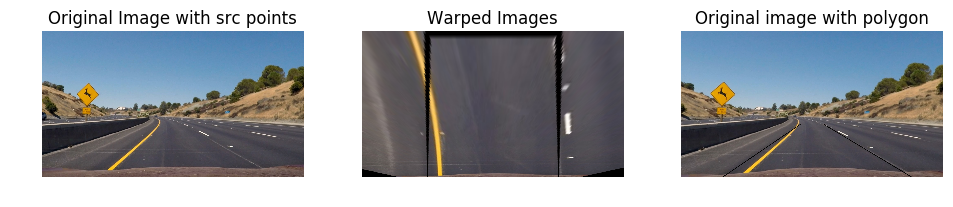

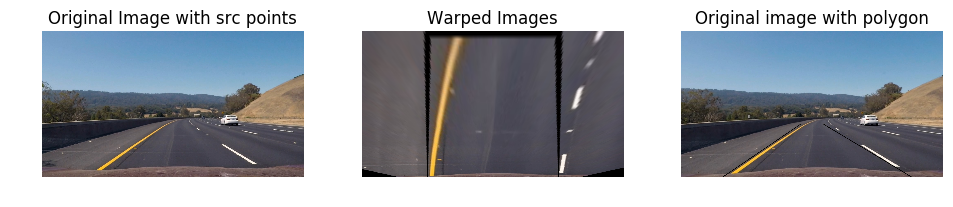

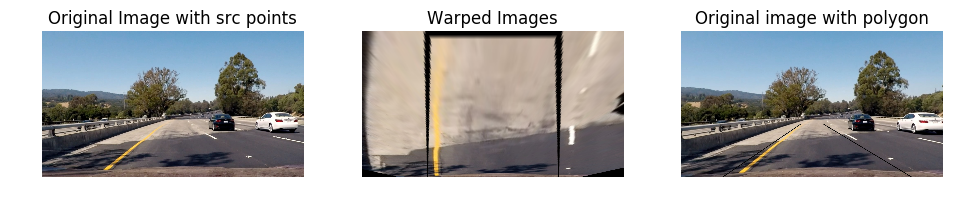

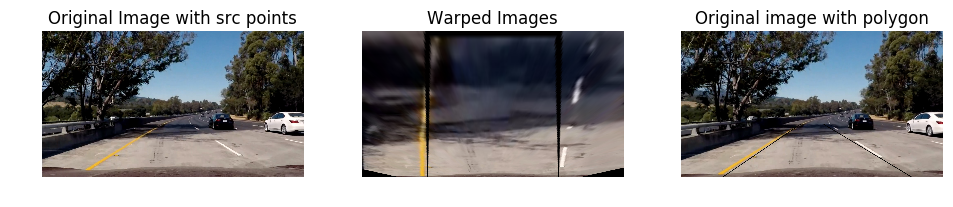

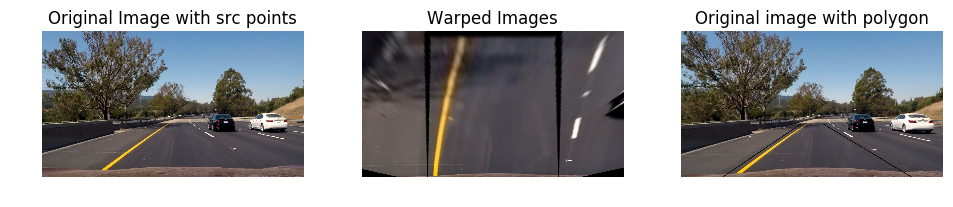

In [12]:
for im in glob.glob('test_images/*.jpg'):                               # 'test_images/straight_lines1.jpg'
    image = mpimg.imread(im)
    undistort_img = undistort_image(np.copy(image))
    img_poly = cv2.polylines(undistort_img , np.array([src]), True, 1, 2)
    warped_img = warpperspective(undistort_img)  
    f, (ax1, ax2,ax3) = plt.subplots(1, 3, figsize=(9, 6))
    f.tight_layout()
    ax1.imshow(image)    
    ax1.set_title('Original Image with src points', fontsize=12)
    ax2.imshow(warped_img)
    ax2.set_title('Warped Images',fontsize=12)
    ax3.imshow(img_poly)
    ax1.axis('off')
    ax2.axis('off')
    ax3.axis('off')
    ax3.set_title('Original image with polygon',fontsize=12)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.) 

#     plt.savefig('./output_images/warped_straight_lines')

# Create binary warped image pipeline

Here use thresholds of the x and y gradients,the overall gradient magnitude,and the gradient direction to focus on pixels that are likely to be part of the lane lines.

In [13]:
def binary_image_pipeline(img):
    # Grayscale image
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Define sobel kernel size
    ksize = 7
    # Apply each of the thresholding functions
    gradx = abs_sobel_thresh(gray, orient='x', sobel_kernel=ksize, thresh=(20, 255))
    grady = abs_sobel_thresh(gray, orient='y', sobel_kernel=ksize, thresh=(80, 255))

    mag_binary = mag_thresh(gray, sobel_kernel=ksize, mag_thresh=(50, 255))
    dir_binary = dir_threshold(gray, sobel_kernel=ksize, thresh=(.65, 1.05))
    
    # Combine all the thresholding information
    combined = np.zeros_like(dir_binary)
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    
    # Threshold color channel:  HLS and HSV Color threshold
    c_binary = color_threshold(img,stresh=(90,255),vthresh=(70,255))  #vthresh=(90,255)) works for main video,not challenge
 
    # Combine two binary thresholds
    
    color_binary = np.zeros_like(combined)
    color_binary[(combined ==1 )|(c_binary==1)] = 1
    
    # Define a four sided polygon to mask and create masked image
  
    vertices = np.array([[(230,720), (512,432),(768,432), (1150,720)]], dtype=np.int32)   
 
    # ROI uses bianry thresholded image in the masked area and vertices.
    color_binary = region_of_interest(color_binary, vertices)
    
    return color_binary

# Visualisation of Binary Image

$After-Applying- ROI$

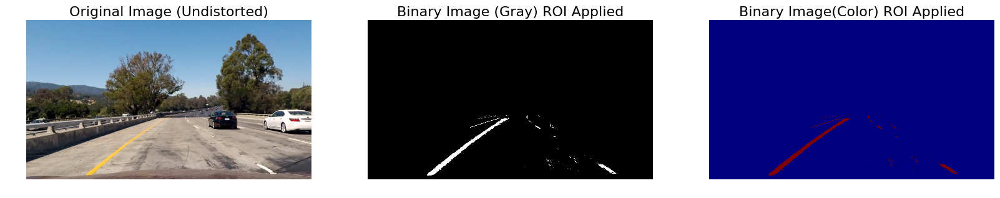

In [14]:
for img in glob.glob('test_images/test1.jpg'):                    #'test_images/test*.jpg'
    img = mpimg.imread(img)
    f, (ax1,ax2,ax3) = plt.subplots(1,3, figsize=(20,10))
    img = cv2.undistort(img,mtx,dist,None,mtx)
    ax1.imshow(img)
    ax1.set_title('Original Image (Undistorted)',fontsize=16)

    # process image and generate binary pixel of interests
    Binary_Image = binary_image_pipeline(np.copy(img))
   
    ax2.imshow(Binary_Image,cmap='gray')
    ax2.set_title('Binary Image (Gray) ROI Applied',fontsize=16)

    ax3.imshow(Binary_Image)
    ax3.set_title('Binary Image(Color) ROI Applied',fontsize=16)
    ax1.axis('off')
    ax2.axis('off')
    ax3.axis('off')
#     plt.savefig('./output_images/binary_image_ROI')

$Prior- Applying - ROI$

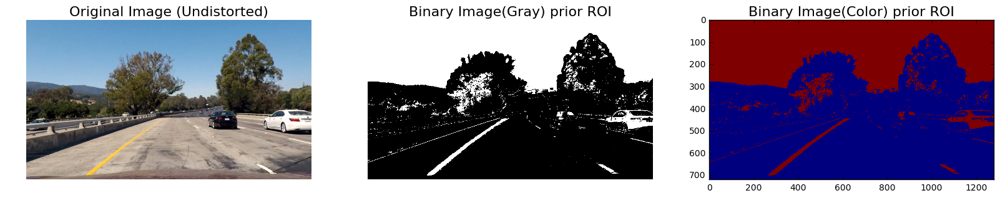

In [15]:
for img in glob.glob('test_images/test1.jpg'):
    img = mpimg.imread(img)
    f, (ax1,ax2,ax3) = plt.subplots(1,3, figsize=(20,10))
    img = cv2.undistort(img,mtx,dist,None,mtx)
    ax1.imshow(img)
    ax1.set_title('Original Image (Undistorted)',fontsize=16)

    # process image and generate binary pixel of interests
    Out_Image = np.zeros_like(img[:,:,0])
    gradx = abs_sobel_thresh(undistort_gray, orient='x', sobel_kernel=ksize,  thresh=(20, 255))  
    grady = abs_sobel_thresh(undistort_gray, orient='y', sobel_kernel=ksize,  thresh=(80, 255)) 
    c_binary = color_threshold(img,stresh=(90,255),vthresh=(40,255))
    Out_Image[((gradx==1)&grady==1)|c_binary==1]= 1 #255
    ax2.imshow(Out_Image,cmap='gray')
    ax2.set_title('Binary Image(Gray) prior ROI',fontsize=16)

    ax3.imshow(Out_Image)
    ax3.set_title('Binary Image(Color) prior ROI',fontsize=16)
    ax1.axis('off')
    ax2.axis('off')
#     plt.savefig('./output_images/binary_image_priorROI')

# Detect lane pixels and fit to find the lane boundary.

In [16]:
# Implement Sliding Windows to extract left and right line pixel positions and Fit a Polynomial
# Code adapted from Udacity Lecture

def Extract_linePixel(binary_warped):
    
    # Histogram of the bottom half of the binary warped image
    histogram = np.sum(binary_warped[binary_warped.shape[0]/2:,:], axis=0)    

    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)                    
    leftx_base = np.argmax(histogram[:midpoint])               
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint   

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 80
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []    

    # Step through the windows one by one and find x,y for left and right
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin

        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
            
    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)  
    
    
    # Extract left and right line pixel positions 
    
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 
    
    # Create a blank image to draw on and  visualize the result
    viz_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    viz_img[lefty, leftx] = [255, 0, 0]
    viz_img[righty, rightx] = [0, 0, 255]
    
    left_fit = np.polyfit(lefty, leftx,2)   
    right_fit = np.polyfit(righty, rightx,2)    

    # here is y data for plotting the ployfit
    y_vals = np.arange(0, img.shape[0])   
    
    left_fitx_poly = np.poly1d(left_fit)   
    left_fitx = left_fitx_poly(y_vals)   
      
    right_fitx_poly = np.poly1d(right_fit)  
    right_fitx = right_fitx_poly(y_vals)   
     
    # Recast the x and y points into usable format for cv2.fillPoly()  
    
    pts_left = np.array([np.transpose(np.vstack([left_fitx, y_vals]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, y_vals])))])
    pts = np.hstack((pts_left, pts_right))  
    
    return leftx,lefty,rightx,righty,pts,viz_img       


# Visualize Warped Image and Histogram 



D:\Anaconda3\lib\site-packages\ipykernel\__main__.py:20: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


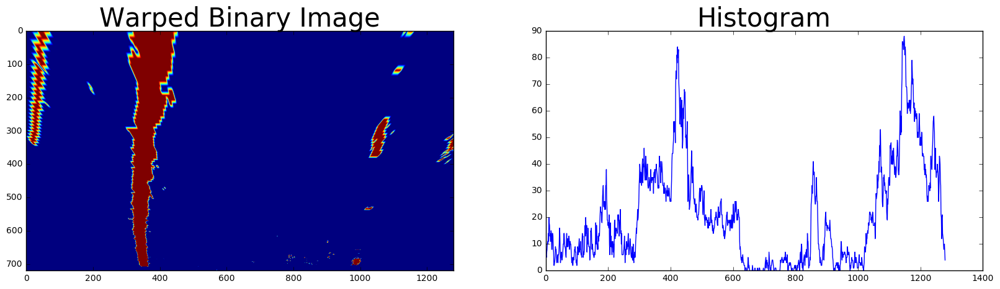

In [17]:
# Plotting a histogram to detect the x location of the lane lines.
# Visualize for all test images

for img in glob.glob('test_images/test1.jpg'):                     #'test_images/test*.jpg'
    img = mpimg.imread(img)
    binary_img = binary_image_pipeline(img)
    binary_warped = warpperspective(binary_img)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,5))
    ax1.imshow(binary_warped)
    ax1.set_title('Warped Binary Image', fontsize=30)
    
    # binary_warped_no_ROI for histogram purpose
    binary_warped_no_ROI = np.zeros_like(img[:,:,0])
    gradx = abs_sobel_thresh(undistort_gray, orient='x', sobel_kernel=ksize,  thresh=(20, 255))  
    grady = abs_sobel_thresh(undistort_gray, orient='y', sobel_kernel=ksize,  thresh=(80, 255))
    c_binary = color_threshold(img,stresh=(90,255),vthresh=(40,255))
    binary_warped_no_ROI[((gradx==1)&grady==1)|c_binary==1]= 1 #255
        
    
    histogram = np.sum(binary_warped_no_ROI[binary_warped_no_ROI.shape[0]/2:,:], axis=0)
    plt.plot(histogram)
    ax2.set_title('Histogram', fontsize=30)
#     plt.savefig('./output_images/warped_Histogram'+im[17:])
    plt.show()

# Visualisation : Identify lane pixels and Fit lines with a 2nd order polynomial

D:\Anaconda3\lib\site-packages\ipykernel\__main__.py:20: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


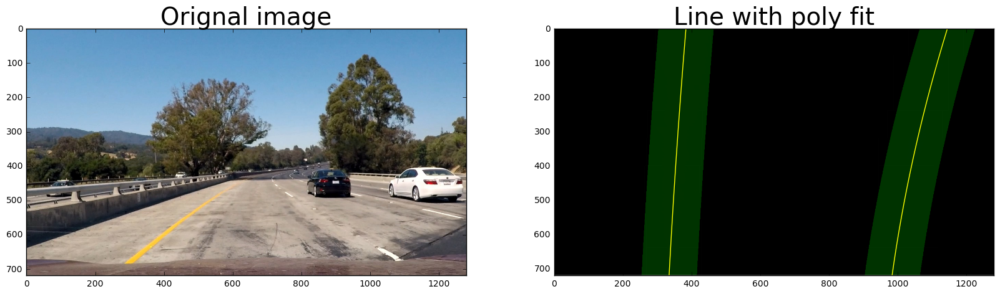

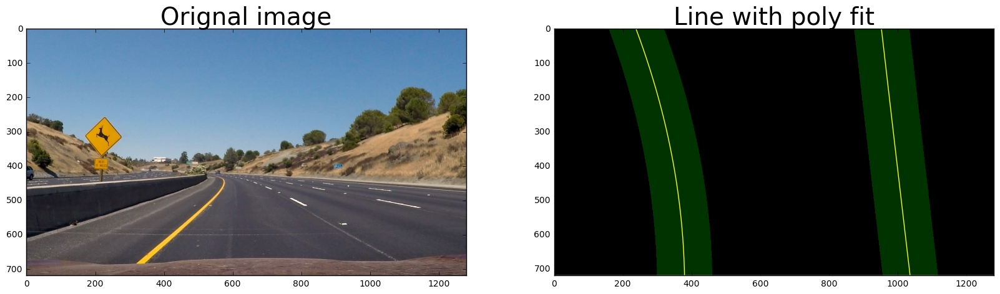

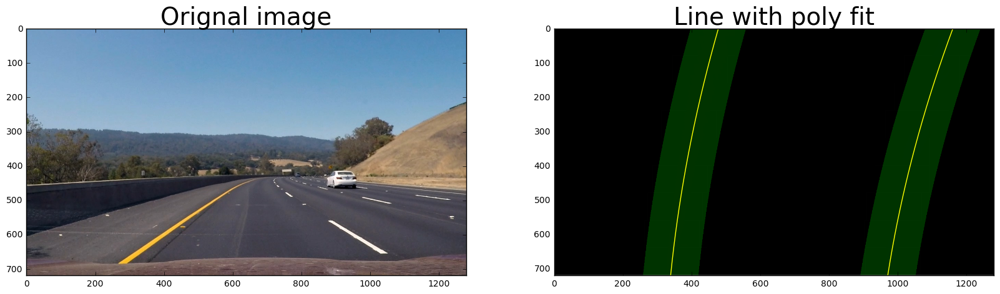

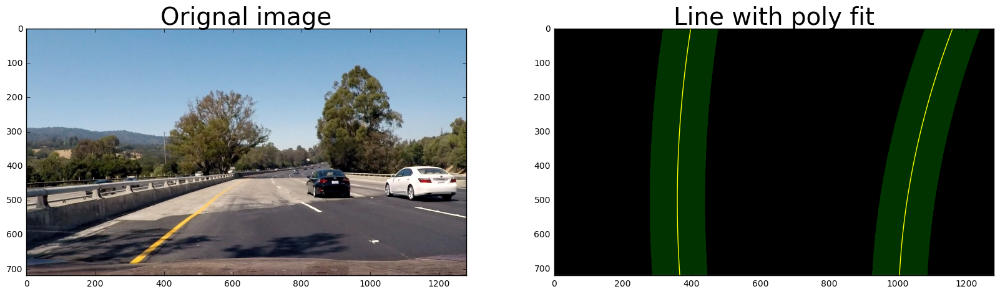

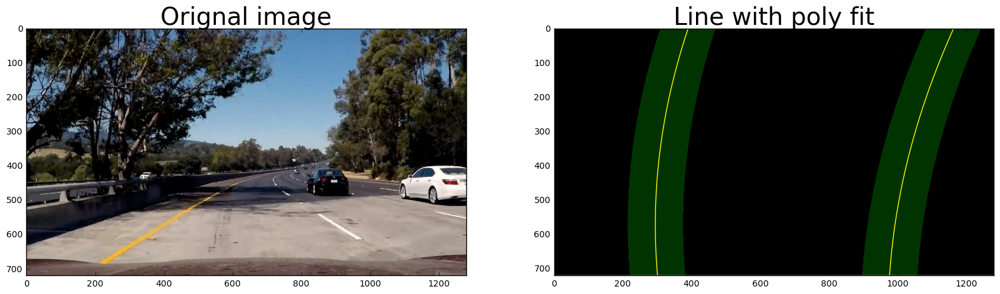

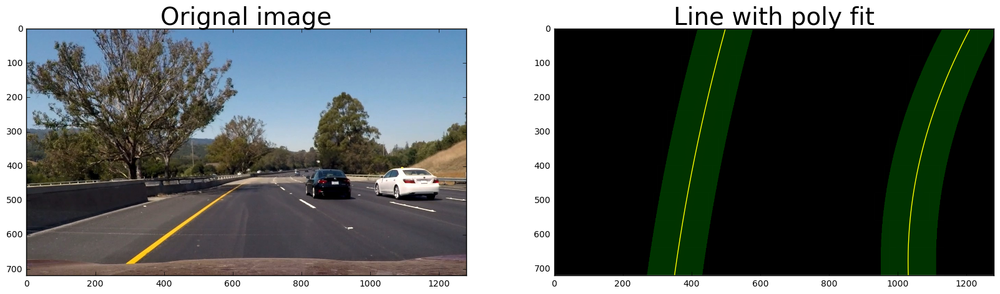

In [18]:
# Code is adapted from Udacity lecture notes

# test_img = mpimg.imread('camera_cal/calibration1.jpg')
# test_img = undistort_image(np.copy(image))


for img in glob.glob('test_images/test*.jpg'):
    img = mpimg.imread(img)
    f, (ax1,ax2) = plt.subplots(1,2, figsize=(20,10))

    ##apply threshold to get the binary image
    binary_img = binary_image_pipeline(img)
    #apply the perspective transform
    binary_warped = warpperspective(binary_img)

    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255

    # Histogram of the bottom half of the binary warped image
    histogram = np.sum(binary_warped[binary_warped.shape[0]/2:,:], axis=0) 
    # plt.plot(histogram)

    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)                      # midpoint : 640
    leftx_base = np.argmax(histogram[:midpoint])                 # leftx_base : 371
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint     # rightx_base : 1054


    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base       
    rightx_current = rightx_base     
    # Set the width of the windows +/- margin
    margin = 80
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []    

    # Step through the windows one by one and find x,y for left and right
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin

         # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(255,255,255), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(255,255,255), 2) 

        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]

        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)

        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)    

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each line

    left_fit = np.polyfit(lefty, leftx,2)   
    right_fit = np.polyfit(righty, rightx,2)   

    # visualize the result
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    fit_leftx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    fit_rightx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    
    window_img = np.zeros_like(out_img)

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([fit_leftx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([fit_leftx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([fit_rightx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([fit_rightx+margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    ax1.imshow(img)
    ax1.set_title('Original image', fontsize=28)
    ax2.imshow(result)
    ax2.set_title('Line with poly fit', fontsize=28)
    plt.plot(fit_leftx, ploty, color='yellow')
    plt.plot(fit_rightx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    plt.show()
#     plt.savefig('./output_images/identified_pixels_fitLine.png')



# Determine the curvature of the lane and vehicle position with respect to center. 

In [19]:
def measure_curvature(img,leftx,lefty,rightx,righty):
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720   # meters per pixel in y dimension
    xm_per_pix = 3.7/700  # meters per pixel in x dimension
    
    # calculate the curvature and distance from lane center
    # The lane center is the midpoint at the bottom of the image between the two lines that are detected. 
    # The distance off the lane center converted from pixels to meters
    
    center_x = (img.shape[1])/2*xm_per_pix
    center_y = img.shape[1]*ym_per_pix    

    # Fit new polynomials to x,y in meters
    
    left_fit = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    
    # Adapted from : Udacity Lectures
    # Calculate the new radii of curvature 
    # Define y-value where we want radius of curvature 
    # The maximum y-value is chosen, corresponding to the bottom of the image
     
    y_eval = img.shape[0]  
        
       
    # Get curvature 
    
    left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
    
    # Purpose:  To calculate distance from center 
    # Using left fit and Right fit polynomial coefficients,find left x and right x line 
    # and subtrtact center to get distance from center 

    leftx_lane = left_fit[0]*center_y**2 + left_fit[1]*center_y + left_fit[2]
    rightx_lane = right_fit[0]*center_y**2 + right_fit[1]*center_y + left_fit[2]
    distance_from_center = leftx_lane + rightx_lane - center_x
    
    ## Now our radius of curvature is in meters
    return left_curverad,right_curverad,distance_from_center 



# Pipeline established with the test images work to process the video

D:\Anaconda3\lib\site-packages\ipykernel\__main__.py:7: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


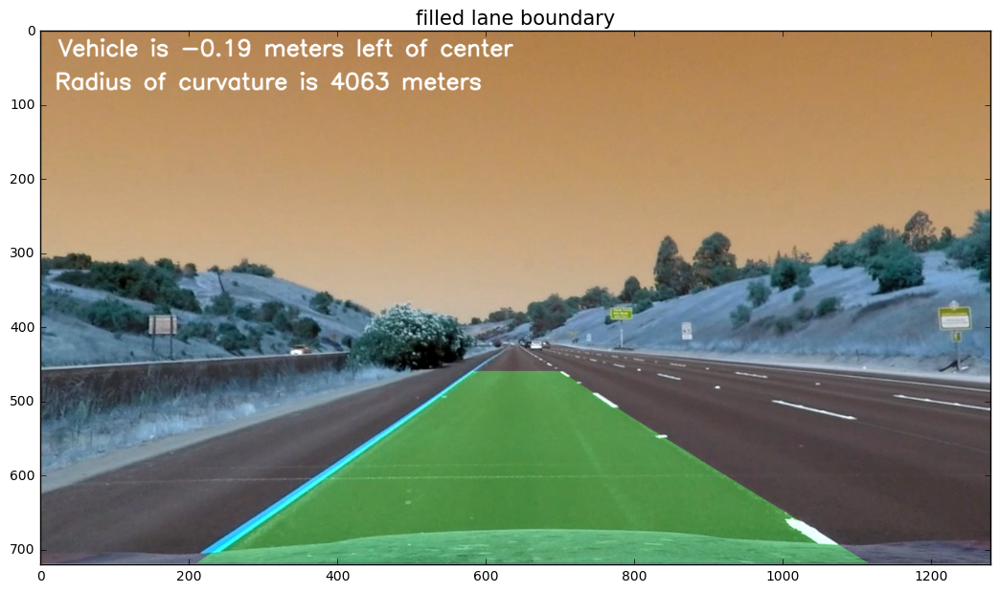

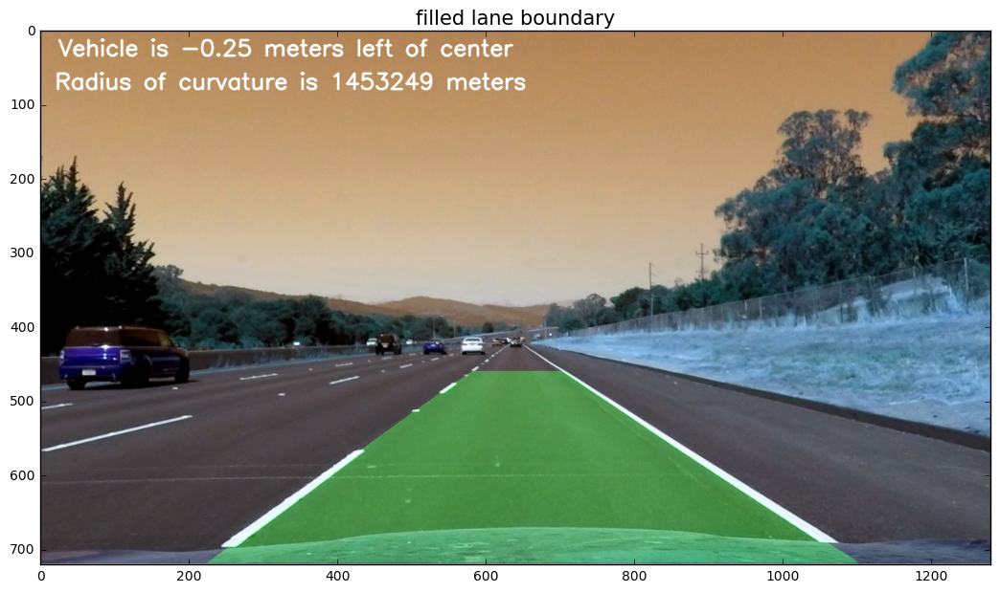

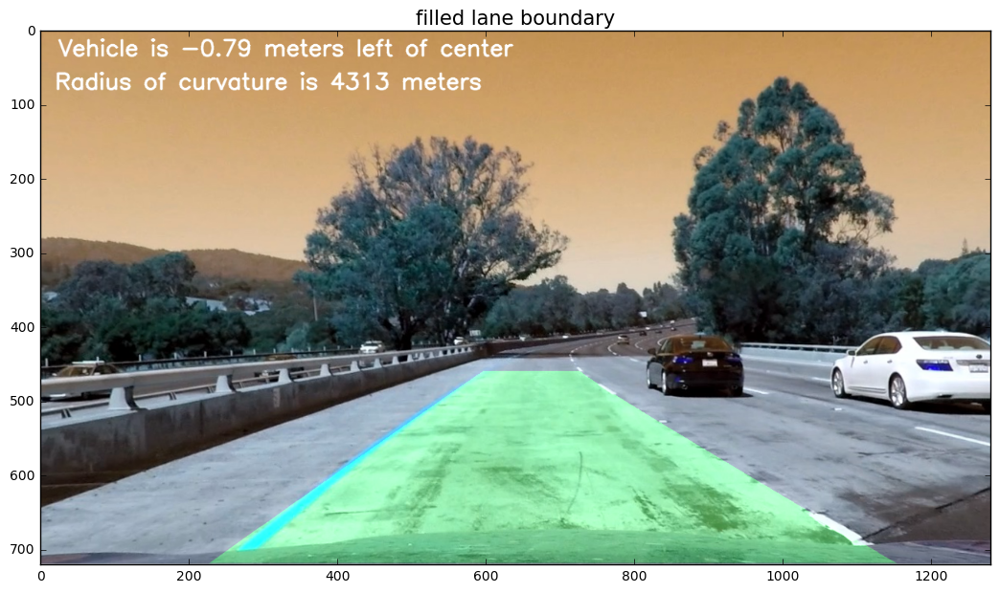

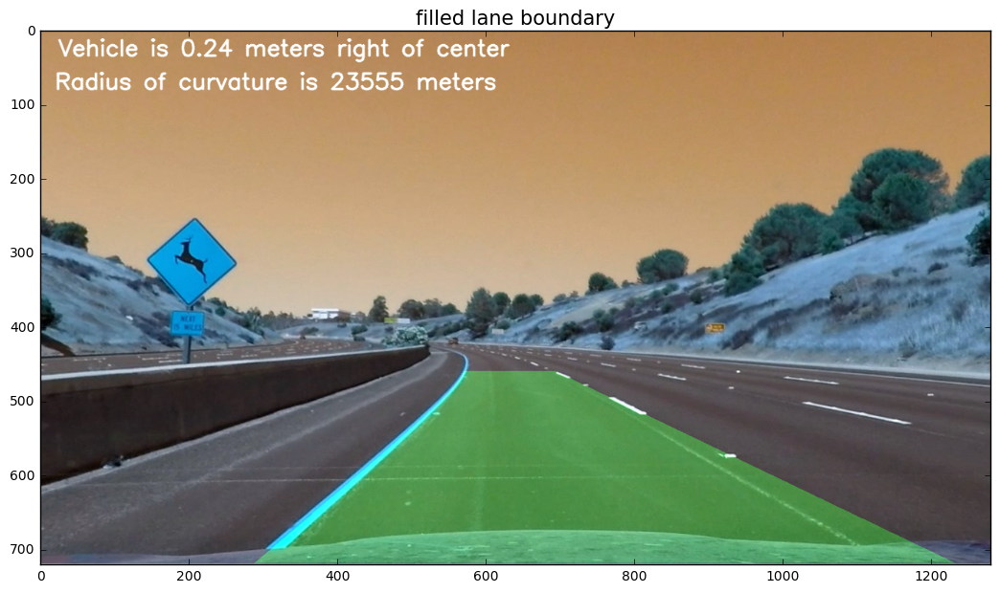

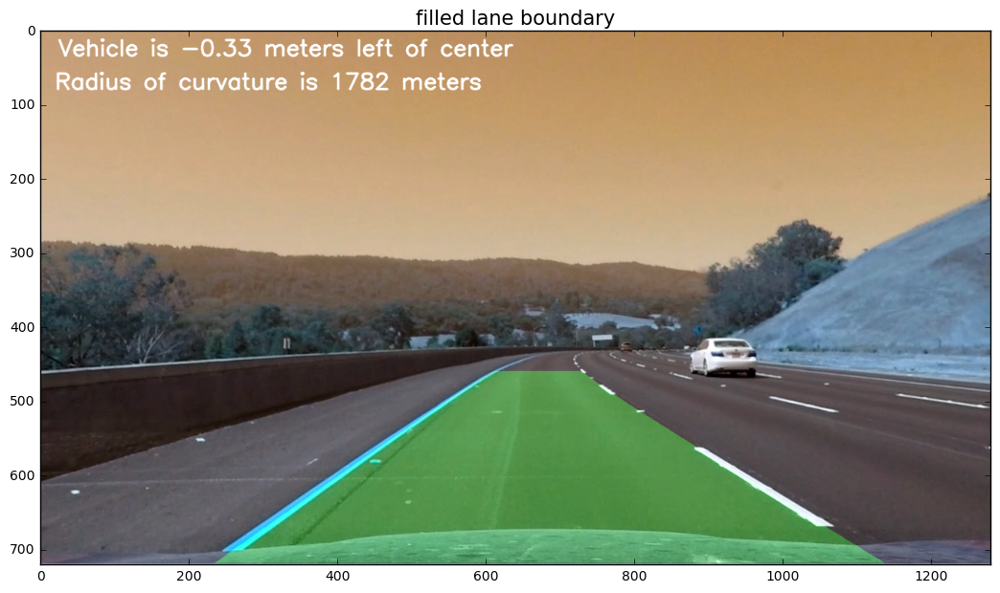

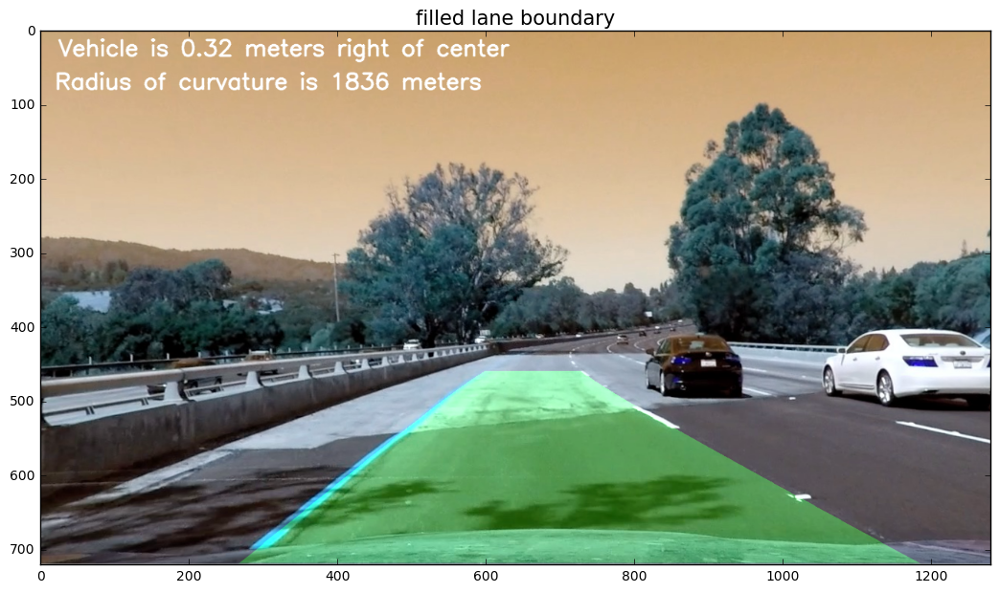

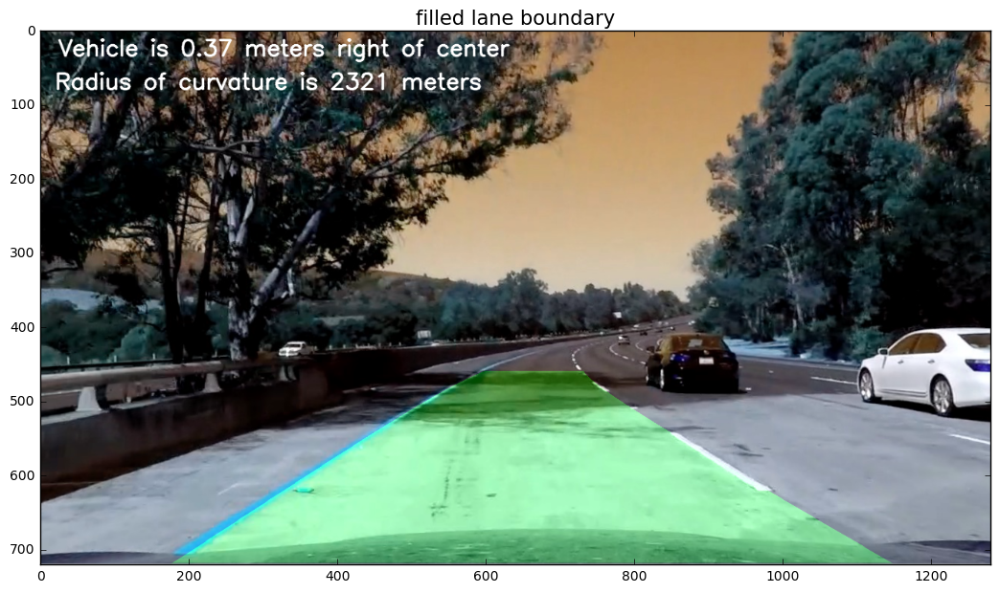

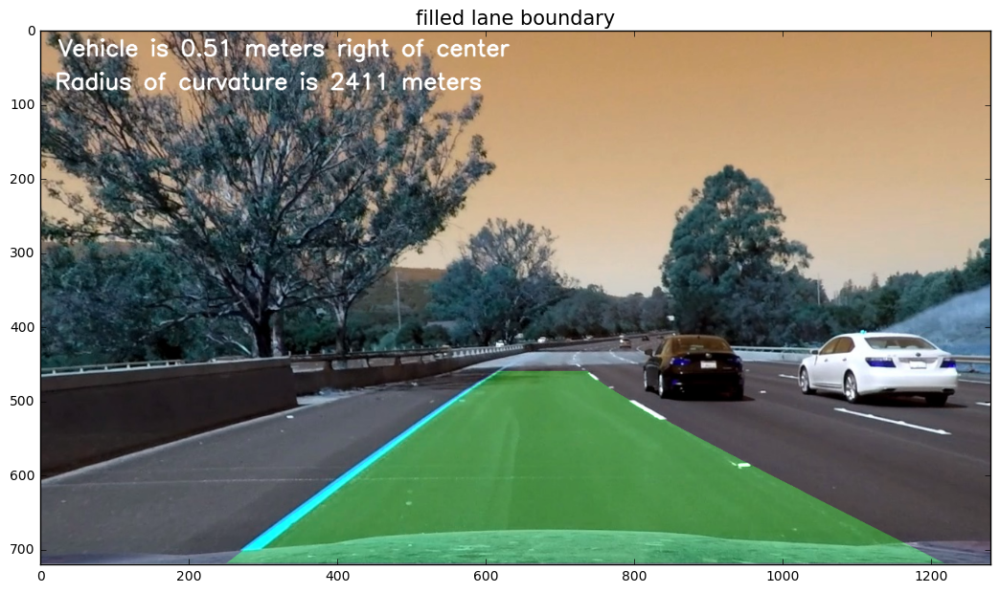

In [20]:
# Warp the detected lane boundaries back onto the original image.

def draw_lane(img):
        #read and undistort the image
        img = undistort_image(img)
        ##apply threshold to get the binary image
        binary_img = binary_image_pipeline(img)
        #apply the perspective transform
        binary_warped = warpperspective(binary_img)
        leftx,lefty,rightx,righty,pts,viz_img = Extract_linePixel(binary_warped)    

        # Create an image to draw the lines on
        color_warp = np.zeros_like(img).astype(np.uint8)
        # Draw the lane onto the warped blank image
        cv2.fillPoly(color_warp, np.int_([pts]), (0, 255, 0))       
              
        # Warp the blank back to original image space using inverse perspective matrix
        newwarp = cv2.warpPerspective(color_warp, PerspectiveInv, (img.shape[1], img.shape[0])) 
        
        # Combine the result with the original image
        result = cv2.addWeighted(img, 1, newwarp, .3, 0)
        
        #calculate the curvature and distance from center
        left_curvature,right_curvature,distance_off_center = measure_curvature(img,leftx,lefty,rightx,righty)
        
        font = cv2.FONT_HERSHEY_SIMPLEX
        
        #write the curvature and distance from center
        cv2.putText(result, 'Radius of curvature is {} meters'.format(int((left_curvature + right_curvature)/2)),(20, 80),
                    font, 1, (255, 255, 255), 2, cv2.LINE_AA)
        
        if distance_off_center < 0:
            cv2.putText(result, 'Vehicle is {:.2f} meters left of center'.format(distance_off_center),(25, 35),
                    font, 1, (255, 255, 255), 2, cv2.LINE_AA)
        else:
            cv2.putText(result, 'Vehicle is {:.2f} meters right of center'.format(distance_off_center),(25, 35),
                    font, 1, (255, 255, 255), 2, cv2.LINE_AA)

        return result

#plot orignal image, and plot the lane on it, also print the radius of the curvature and offsets
for im in glob.glob('test_images/*.jpg'):
    image = mpimg.imread(im)
    img = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    result = draw_lane(img)
    plt.figure(figsize=(12.8,7.2))
    plt.imshow(result)
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    #plt.axis('off')
    plt.title('filled lane boundary', fontsize=15)
#     plt.savefig('./output_images/filled-lane-boundary.png')

# Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

In [21]:
from moviepy.editor import VideoFileClip
#process on project video
output1 = 'project_video_solution.mp4'
clip1 = VideoFileClip("project_video.mp4")
white_clip = clip1.fl_image(draw_lane) #NOTE: this function expects color images!!
%time white_clip.write_videofile(output1, audio=False)

[MoviePy] >>>> Building video project_video_solution.mp4
[MoviePy] Writing video project_video_solution.mp4


100%|█████████████████████████████████████▉| 1260/1261 [06:37<00:00,  3.26it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_solution.mp4 

Wall time: 6min 38s


# Challenge Video Pipeline 

# HSV removed from binary_image_pipeline_challenge function

In [22]:
def binary_image_pipeline_challenge(img):
    # Grayscale image
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Define sobel kernel size
    ksize = 3
    # Apply each of the thresholding functions
    gradx = abs_sobel_thresh(gray, orient='x', sobel_kernel=ksize, thresh=(20, 255))
    grady = abs_sobel_thresh(gray, orient='y', sobel_kernel=ksize, thresh=(80, 255))

    mag_binary = mag_thresh(gray, sobel_kernel=ksize, mag_thresh=(50, 255))
    dir_binary = dir_threshold(gray, sobel_kernel=ksize, thresh=(.65, 1.05))
    
    # Combine all the thresholding information
    combined = np.zeros_like(dir_binary)
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    
    # Threshold color channel:  HLS threshold
    c_binary = color_threshold(img,stresh=(90,255)) 
 
    # Combine two binary thresholds
    
    color_binary = np.zeros_like(combined)
    color_binary[(combined ==1 )|(c_binary==1)] = 1
    
    # Define a four sided polygon to mask and create masked image
  
    vertices = np.array([[(230,720), (512,432),(768,432), (1150,720)]], dtype=np.int32)   
 
    # ROI uses bianry thresholded image in the masked area and vertices.
    color_binary = region_of_interest(color_binary, vertices)
    
    return color_binary

In [23]:
def draw_lane_challenge(img):
        #read and undistort the image
        img = undistort_image(img)
        ##apply threshold to get the binary image
        binary_img = binary_image_pipeline_challenge(img)
        #apply the perspective transform
        binary_warped = warpperspective(binary_img)
        leftx,lefty,rightx,righty,pts,viz_img  = Extract_linePixel(binary_warped)    

        # Create an image to draw the lines on
        color_warp = np.zeros_like(img).astype(np.uint8)
        # Draw the lane onto the warped blank image
        cv2.fillPoly(color_warp, np.int_([pts]), (0, 255, 0))       
              
        # Warp the blank back to original image space using inverse perspective matrix
        newwarp = cv2.warpPerspective(color_warp, PerspectiveInv, (img.shape[1], img.shape[0])) 
        
        # Combine the result with the original image
        result = cv2.addWeighted(img, 1, newwarp, .3, 0)
        
        #calculate the curvature and distance from center
        left_curvature,right_curvature,distance_off_center = measure_curvature(img,leftx,lefty,rightx,righty)
        
        font = cv2.FONT_HERSHEY_SIMPLEX
        
        #write the curvature and distance from center
        
        cv2.putText(result, 'Radius of curvature is {} meters'.format(int((left_curvature + right_curvature)/2)),(20, 80),
                    font, 1, (255, 255, 255), 2, cv2.LINE_AA)
      
        if distance_off_center < 0:
            cv2.putText(result, 'Vehicle is {:.2f} meters left of center'.format(distance_off_center),(25, 35),
                    font, 1, (255, 255, 255), 2, cv2.LINE_AA)
        else:
            cv2.putText(result, 'Vehicle is {:.2f} meters right of center'.format(distance_off_center),(25, 35),
                    font, 1, (255, 255, 255), 2, cv2.LINE_AA)
        return result



In [24]:
from moviepy.editor import VideoFileClip
#process on project video
output1 = 'challenge_solution.mp4'
clip1 = VideoFileClip("challenge_video.mp4")
white_clip = clip1.fl_image(draw_lane_challenge) 
%time white_clip.write_videofile(output1, audio=False)

[MoviePy] >>>> Building video challenge_solution.mp4
[MoviePy] Writing video challenge_solution.mp4


100%|████████████████████████████████████████| 485/485 [02:16<00:00,  3.78it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: challenge_solution.mp4 

Wall time: 2min 16s


In [25]:
from moviepy.editor import VideoFileClip
#process on project video
output1 = 'harder_challenge_solution.mp4'
clip1 = VideoFileClip("harder_challenge_video.mp4")
white_clip = clip1.fl_image(draw_lane_challenge) 
%time white_clip.write_videofile(output1, audio=False)

[MoviePy] >>>> Building video harder_challenge_solution.mp4
[MoviePy] Writing video harder_challenge_solution.mp4


100%|█████████████████████████████████████▉| 1199/1200 [06:13<00:00,  3.37it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: harder_challenge_solution.mp4 

Wall time: 6min 14s
